In [1]:
#!/usr/bin/env python2
import os
import sys
import argparse
import time
from distutils.dir_util import copy_tree

import numpy as np
import random
import theano
import theano.tensor as T
from theano import config
import lasagne
from lasagne.regularization import regularize_network_params
from lasagne.objectives import binary_crossentropy

from iterator import Iterator
import cnn_model as ae_model
import gan_model as gan_model

import PIL.Image as Image
from matplotlib import pyplot as plt
from matplotlib import colors
%matplotlib inline


_FLOATX = config.floatX


In [2]:
#Training hyper-parameters

learning_rate = 0.01
weight_decay = 0
num_epochs = 500
max_patience = 100
#data_augmentation={}
SAVEPATH = 'save_models' 
LOADPATH = 'load_models'
batch_size = 400
extract_center = True
load_caption = True
#nb_discriminator_steps = 2

#Model Hyperparameters
conv_before_pool=[2,2]
n_filters = 32                      
code_size = 750
filter_size = 3
pool_factor = 2



In [3]:
#######################
# Saving path and stuff
######################
exp_name = 'nb_AE_caps_adv'
exp_name += '_lr='+str(learning_rate)
exp_name += '_wd='+str(weight_decay)
exp_name += '_bs='+str(batch_size)
exp_name += '_conv='+str(conv_before_pool)
exp_name += '_nfilt='+str(n_filters)
exp_name += '_code='+str(code_size)




savepath=os.path.join(sys.path[1],SAVEPATH, exp_name)
loadpath=os.path.join(sys.path[1],LOADPATH, exp_name)

if not os.path.exists(savepath):
    os.makedirs(savepath)
else:
    print('\033[93m The following folder already exists {}. '
          'It will be overwritten in a few seconds...\033[0m'.format(
              savepath))
print 'Saving directory : ' + savepath
print 'Loading directory : '+ loadpath

 The following folder already exists /u/larocste/ift6266_project/save_models/nb_AE_caps_adv_lr=0.01_wd=0_bs=400_conv=[2, 2]_nfilt=32_code=750. It will be overwritten in a few seconds...
Saving directory : /u/larocste/ift6266_project/save_models/nb_AE_caps_adv_lr=0.01_wd=0_bs=400_conv=[2, 2]_nfilt=32_code=750
Loading directory : /u/larocste/ift6266_project/load_models/nb_AE_caps_adv_lr=0.01_wd=0_bs=400_conv=[2, 2]_nfilt=32_code=750


In [4]:
#######################
#Build dataset iterator
#######################

print "Loading training data..." #threads???
train_iter = Iterator(which_set='train', batch_size = batch_size,
            extract_center = extract_center, load_caption = load_caption)

print "Loading validation data..." #threads???
valid_iter = Iterator(which_set='valid', batch_size = batch_size,
            extract_center = extract_center, load_caption = load_caption)

test_iter = None

vocab_size = len(train_iter.vocab)
print 'Vocabulary size : ', vocab_size

n_batches_train = train_iter.n_batches
n_batches_valid = valid_iter.n_batches
n_batches_test = test_iter.n_batches if test_iter is not None else 0

print "Batch. train: %d, val %d, test %d" % (n_batches_train,
                            n_batches_valid, n_batches_test)

Loading training data...
Loading the captions...
Done
We have a vocabulary of size 7574
processing the text...
Done
Loading validation data...
Loading the captions...
Done
We have a vocabulary of size 7574
processing the text...
Done
Vocabulary size :  7574
Batch. train: 206, val 101, test 0


In [5]:
# def put_center(contour, center):
#     n_samples = np.shape(contour)[0]
#     print np.shape(contour[0]), n_samples
#     full_img=np.zeros(contour)
#     np.copyto(full_img,contour)
#     full_img[:,:,16:48,16:48] = center
    
#     return full_img
    
    

In [6]:
##########################################
# Build generator and discriminator models
##########################################
print('Defining symbolic variables and building models')

#Input and target var for the generator
ae_input_var = T.tensor4('input img bx3x32x32')
ae_captions_var = T.matrix('captions var')


model = ae_model.AE_contour2center_captions()

model.build_network(input_var = ae_input_var,
                  captions_var = ae_captions_var,
                  conv_before_pool=conv_before_pool,
                  n_filters = n_filters,
                  code_size = code_size,
                  filter_size = filter_size,
                  pool_factor = pool_factor)


Defining symbolic variables and building models


In [7]:

ae_target_var = T.tensor4('target var bx3x32x32')

D = gan_model.discriminator()
D.build_network(input_var = ae_target_var, contour_var = ae_input_var, conv_before_pool = [1,1,1,1])

D_over_G = gan_model.discriminator_over_generator()
D_over_G.build_network(G_net = model, D_net=D)

In [8]:
model.compile_theano_functions(learning_rate= learning_rate, comp_train = False, comp_valid=False)

Defining and compiling get_imgs function
Done


In [9]:
# ##########################################
# # Build generator and discriminator models
# ##########################################

# #Print layers and shape (to debug)
# # print 'AE layers'

# for layer in lasagne.layers.get_all_layers(D.net):
#     print layer, layer.output_shape

for l in D.dict_net:
    print l, D.dict_net[l], D.dict_net[l].output_shape


conv0_0 <lasagne.layers.conv.Conv2DLayer object at 0x7fd7bc9c67d0> (None, 32, 33, 33)
bn0_0 <lasagne.layers.normalization.BatchNormLayer object at 0x7fd7bc9c6d10> (None, 32, 33, 33)
nonlin3_0 <lasagne.layers.special.NonlinearityLayer object at 0x7fd7bc9eb4d0> (None, 256, 6, 6)
bn2_0 <lasagne.layers.normalization.BatchNormLayer object at 0x7fd7bc9e0210> (None, 128, 10, 10)
bn1_0 <lasagne.layers.normalization.BatchNormLayer object at 0x7fd7bc9d4790> (None, 64, 18, 18)
noise_to_input <lasagne.layers.noise.GaussianNoiseLayer object at 0x7fd7bc9c6610> (None, 3, 32, 32)
nonlin1_0 <lasagne.layers.special.NonlinearityLayer object at 0x7fd7bc9d4fd0> (None, 64, 18, 18)
nonlin0_0 <lasagne.layers.special.NonlinearityLayer object at 0x7fd7bc9d4590> (None, 32, 33, 33)
bn3_0 <lasagne.layers.normalization.BatchNormLayer object at 0x7fd7bc9e0c50> (None, 256, 6, 6)
nonlin2_0 <lasagne.layers.special.NonlinearityLayer object at 0x7fd7bc9e0a50> (None, 128, 10, 10)
real_last_layer <lasagne.layers.special.No

In [10]:
#####################################
# Define and compile theano functions
#####################################

print "Defining and compiling theano functions"

l1 = 0.5
l2 = 1-l1

pred_img = lasagne.layers.get_output(model.net)
rec_loss = model.get_loss(pred_img, ae_target_var)


D_predictions = lasagne.layers.get_output(D.net)
D_over_G_predictions = lasagne.layers.get_output(D_over_G.net)

D_pred_cost = binary_crossentropy(D_predictions,1)# np.random.rand())
D_over_G_pred_cost = binary_crossentropy(D_over_G_predictions, 0)# np.random.rand())


adv_loss = -T.mean(T.log(D_predictions)  + T.log(1 - D_over_G_predictions))
#adv_loss = T.mean(D_over_G_pred_cost + D_pred_cost)

joint_loss = l1*rec_loss + l2 *T.mean(D_over_G_pred_cost)


print 'model.train_fn'
ae_params = lasagne.layers.get_all_params(model.net, trainable=True)
ae_updates = lasagne.updates.adam(joint_loss, ae_params, learning_rate = 0.005)
model.train_fn = theano.function([ae_input_var,ae_captions_var, ae_target_var], joint_loss, updates = ae_updates,
                            allow_input_downcast=True)



print 'D.train_fn'
D_params = lasagne.layers.get_all_params(D.net, trainable=True)
D_updates = lasagne.updates.adam(-adv_loss, D_params, learning_rate=0.0001)
D.train_fn = theano.function([ae_input_var, ae_captions_var, ae_target_var], -adv_loss, updates=D_updates,
                            allow_input_downcast=True, on_unused_input='ignore')

print 'Done'



Defining and compiling theano functions
model.train_fn
D.train_fn
Done


In [11]:
D.get_pred = theano.function([ae_input_var, ae_captions_var, ae_target_var], D_predictions, on_unused_input='ignore')
D_over_G.get_pred = theano.function([ae_input_var, ae_captions_var, ae_target_var], D_over_G_predictions, on_unused_input='ignore')

In [12]:
D.get_before_nonlin = theano.function([ae_input_var, ae_captions_var, ae_target_var], 
                                      lasagne.layers.get_output(D.dict_net['last_layer']), on_unused_input='ignore')
D_over_G.get_before_nonlin = theano.function([ae_input_var, ae_captions_var, ae_target_var], 
                                      lasagne.layers.get_output(D_over_G.dict_net['last_layer']), on_unused_input='ignore')

In [13]:
plot_results_train = True
plot_results_valid = True


num_epochs = 20
n_batches_train = 1
n_batches_valid = 1

In [14]:
# Initialization

err_train = []
err_valid = []

best_err_val = 0
patience = 2

reset_best_results = True

Start training
D cost batch 0 -1.7389074564


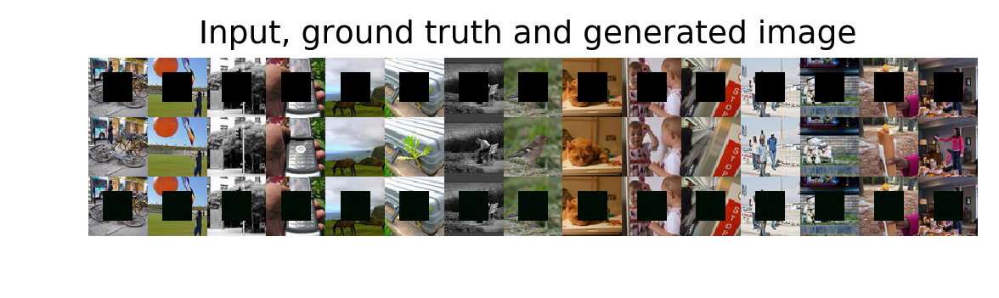

ae cost batch  1.22273910046
ae cost batch  0.457541614771
ae cost batch  0.209012955427
ae cost batch  0.160898000002
D cost batch 5 -0.805506944656
ae cost batch  0.131442248821
ae cost batch  0.120867148042
ae cost batch  0.112882055342
ae cost batch  0.110200837255


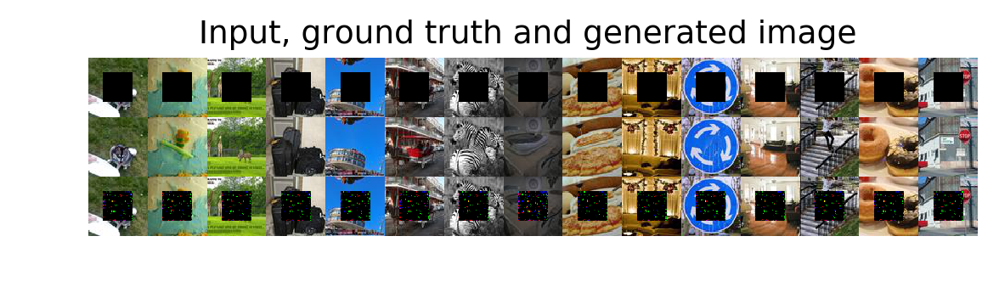

D cost batch 10 -1.22343063354
ae cost batch  0.105522207916
ae cost batch  0.103094145656
ae cost batch  0.105491630733
ae cost batch  0.103825725615
D cost batch 15 -1.92985475063
ae cost batch  0.0986493751407
ae cost batch  0.0999626740813
ae cost batch  0.102363921702


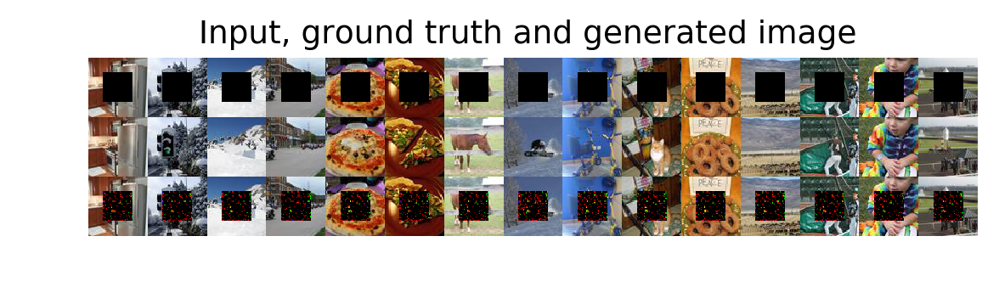

ae cost batch  0.101356975734
D cost batch 20 -2.7281897068
ae cost batch  0.0977720841765
ae cost batch  0.10078766942
ae cost batch  0.0970258414745
ae cost batch  0.0986144393682
D cost batch 25 -3.83518123627
ae cost batch  0.0971380770206
ae cost batch  0.0911734998226


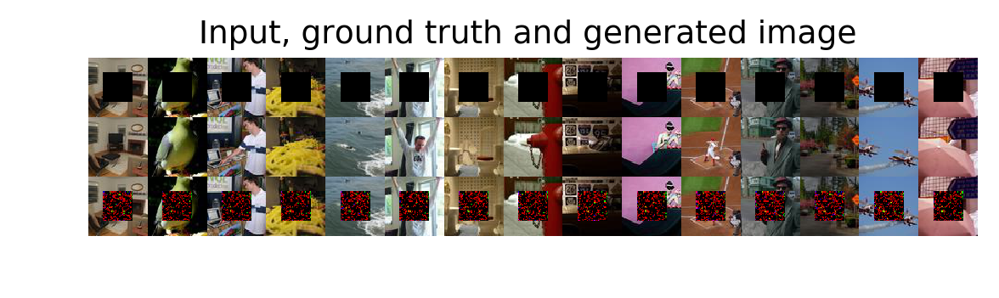

ae cost batch  0.0914784446359
ae cost batch  0.0941789746284
D cost batch 30 -4.88148498535
ae cost batch  0.090473972261
ae cost batch  0.0857510715723
ae cost batch  0.0831216052175
ae cost batch  0.0864263698459
D cost batch 35 -6.05881261826
ae cost batch  0.0825984701514


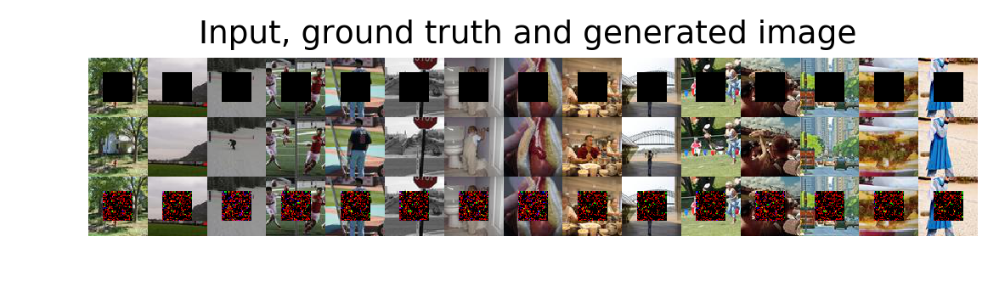

ae cost batch  0.082523830235
ae cost batch  0.0806714370847
ae cost batch  0.0774618983269
D cost batch 40 -7.24211072922
ae cost batch  0.0756665915251
ae cost batch  0.0799875184894
ae cost batch  0.0736462920904
ae cost batch  0.0733499079943
D cost batch 45 -8.44814109802


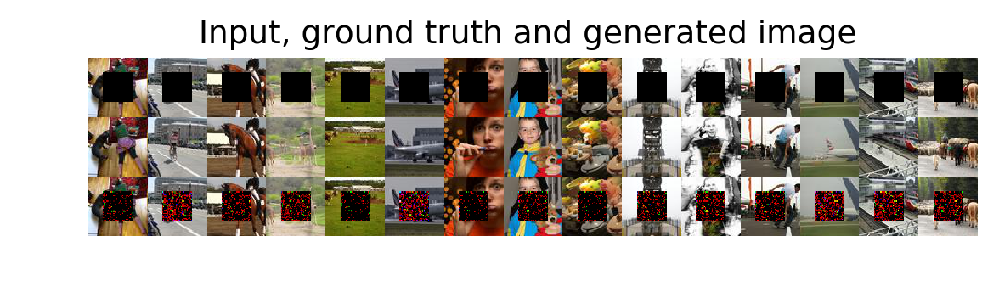

ae cost batch  0.0684631615877
ae cost batch  0.0725418478251
ae cost batch  0.0660476982594
ae cost batch  0.0626894235611
D cost batch 50 -9.67466640472
ae cost batch  0.0607170313597
ae cost batch  0.0599011480808
ae cost batch  0.0584257617593
ae cost batch  0.0526084899902


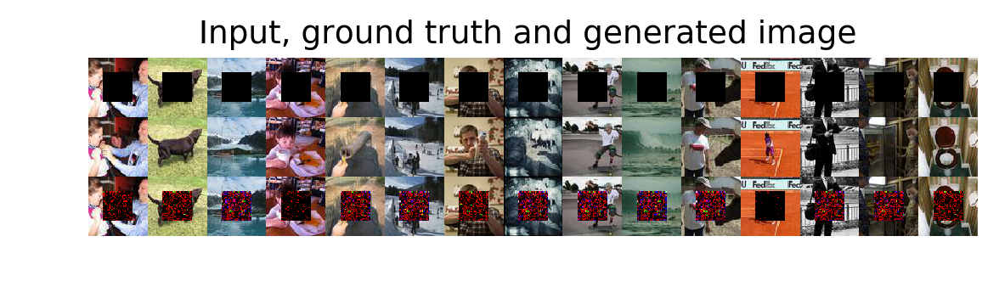

EPOCH 0: Avg cost train 5.587093, cost val 0.000000, took 76.515085 s
ae cost batch  0.0516988374293


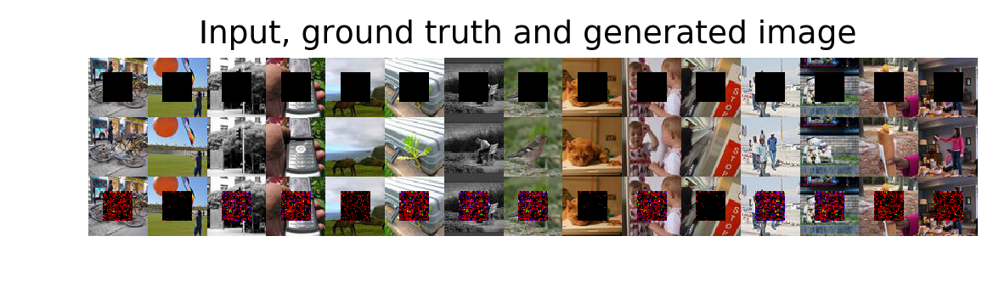

ae cost batch  0.0508514717221
ae cost batch  0.0517265200615
ae cost batch  0.0502880103886
D cost batch 4 -10.8684034348
ae cost batch  0.0477603673935
ae cost batch  0.0470537692308
ae cost batch  0.0466120988131
ae cost batch  0.0441718287766
D cost batch 9 -12.0502662659


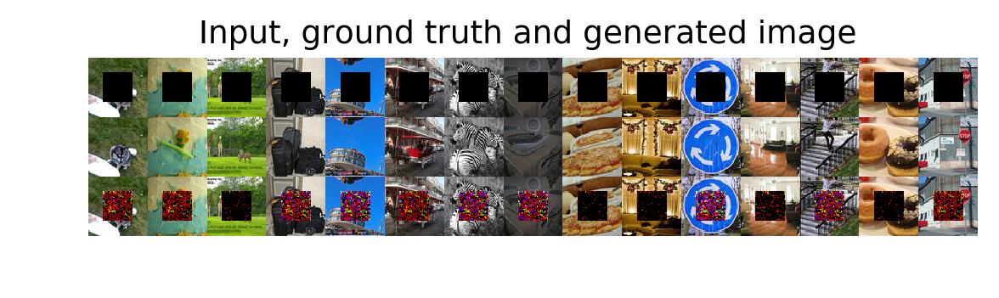

ae cost batch  0.0434562154114
ae cost batch  0.0465338043869
ae cost batch  0.0435795634985
ae cost batch  0.0422144941986
D cost batch 14 -13.1245040894
ae cost batch  0.0415476225317
ae cost batch  0.0410063937306
ae cost batch  0.0409989319742
ae cost batch  0.0432478450239


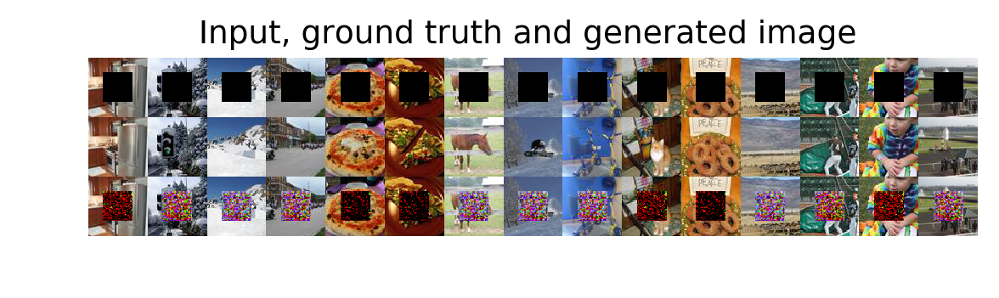

D cost batch 19 -14.3227548599
ae cost batch  0.0419672578573
ae cost batch  0.0403550639749
ae cost batch  0.0422099493444
ae cost batch  0.0406101383269
D cost batch 24 -15.5362796783
ae cost batch  0.0397121198475
ae cost batch  0.043759804219
ae cost batch  0.0398371852934


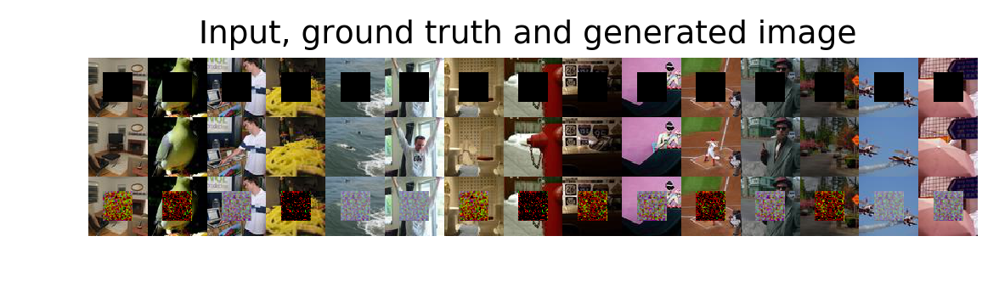

ae cost batch  0.0392146669328
D cost batch 29 -16.6739730835
ae cost batch  0.0399345606565
ae cost batch  0.0393617898226
ae cost batch  0.0410490296781
ae cost batch  0.0387307703495
D cost batch 34 -17.7247619629
ae cost batch  0.0373923107982
ae cost batch  0.0394092015922


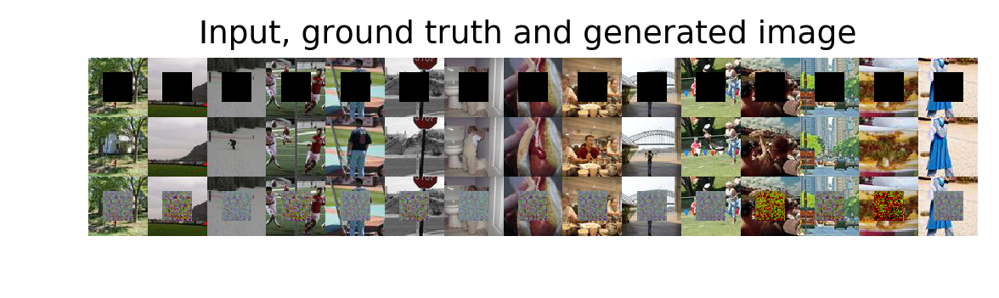

ae cost batch  0.0402290150523
ae cost batch  0.0378805026412
D cost batch 39 -18.8230266571
ae cost batch  0.0398921072483
ae cost batch  0.036136996001
ae cost batch  0.0386528670788
ae cost batch  0.0450530014932
D cost batch 44 -19.9321556091
ae cost batch  0.0380201525986


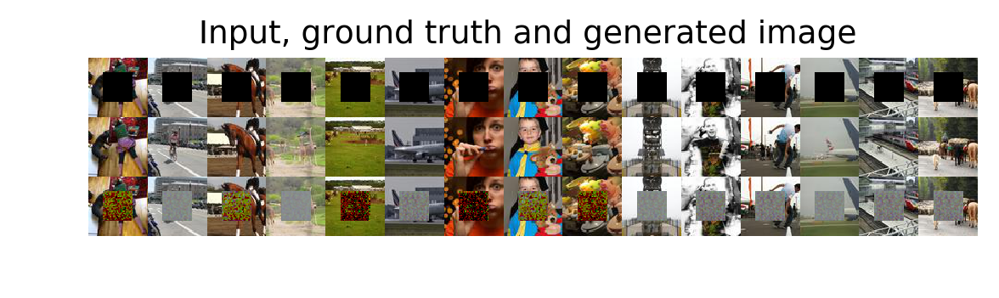

ae cost batch  0.0356089062989
ae cost batch  0.0381101220846
ae cost batch  0.0386851169169
D cost batch 49 -21.1184558868
ae cost batch  0.0390149913728
ae cost batch  0.0367886684835
ae cost batch  0.0374379083514
ae cost batch  0.0382383018732
D cost batch 54 -22.1384563446


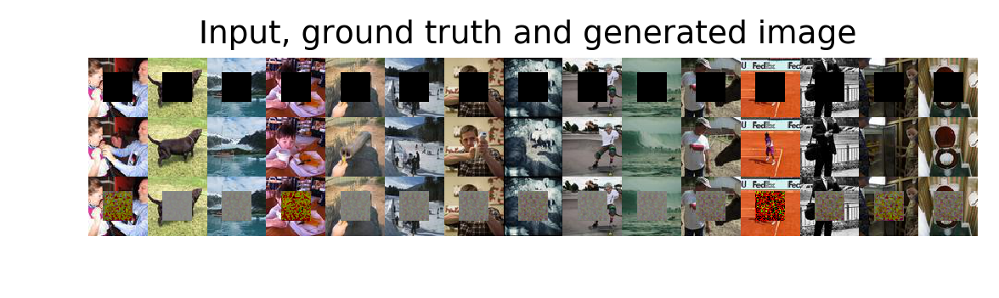

EPOCH 1: Avg cost train 1.836040, cost val 0.000000, took 69.788674 s
ae cost batch  0.0354954376817


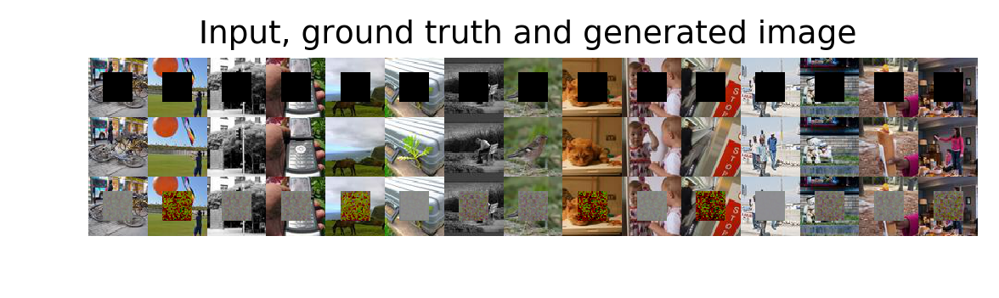

ae cost batch  0.0367970168591
ae cost batch  0.0378079228103
D cost batch 3 -23.3740901947
ae cost batch  0.03589066118
ae cost batch  0.0363444276154
ae cost batch  0.0355041250587
ae cost batch  0.0359207876027
D cost batch 8 -24.3352031708
ae cost batch  0.0350613519549


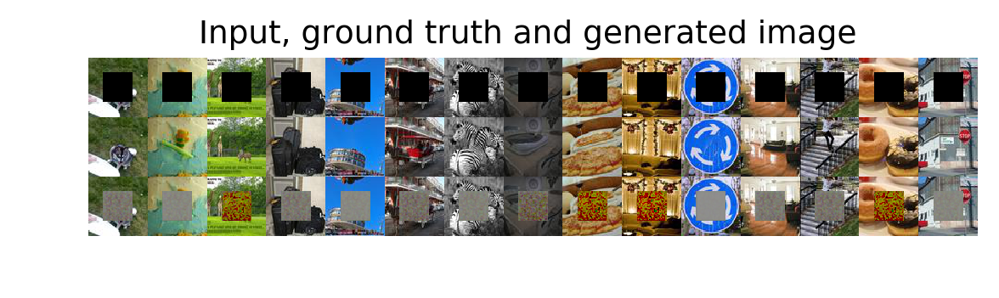

ae cost batch  0.0341561920941
ae cost batch  0.0380054078996
ae cost batch  0.0353411771357
D cost batch 13 -25.469209671
ae cost batch  0.0340666361153
ae cost batch  0.0348908193409
ae cost batch  0.0332497321069
ae cost batch  0.0336843319237
D cost batch 18 -26.3799591064


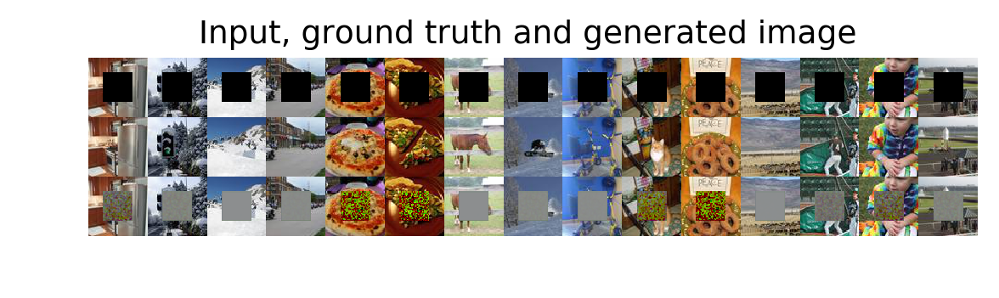

ae cost batch  0.0384059585631
ae cost batch  0.0352666079998
ae cost batch  0.0335558950901
ae cost batch  0.0343437306583
D cost batch 23 -27.5993652344
ae cost batch  0.0350107774138
ae cost batch  0.0336059480906
ae cost batch  0.0414350479841
ae cost batch  0.0343308523297


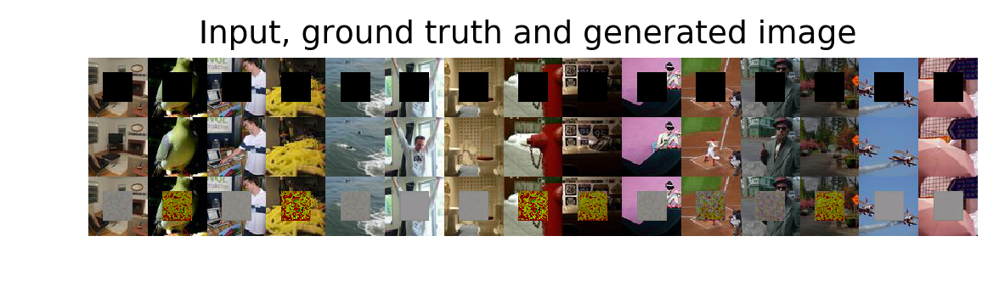

D cost batch 28 -28.6236476898
ae cost batch  0.0356932580471
ae cost batch  0.0348666161299
ae cost batch  0.0352217070758
ae cost batch  0.0363287366927
D cost batch 33 -29.6738471985
ae cost batch  0.0368606932461
ae cost batch  0.035188999027
ae cost batch  0.0348894894123


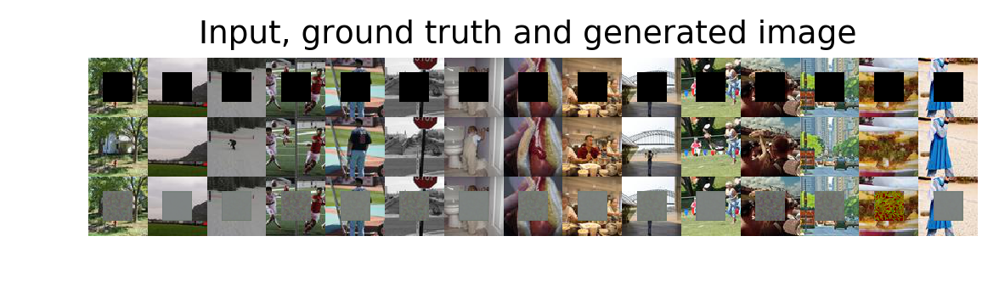

ae cost batch  0.038010969758
D cost batch 38 -30.6808929443
ae cost batch  0.0325353033841
ae cost batch  0.0369026809931
ae cost batch  0.0332549698651
ae cost batch  0.0350641310215
D cost batch 43 -31.7414493561
ae cost batch  0.0341263785958
ae cost batch  0.0357428975403


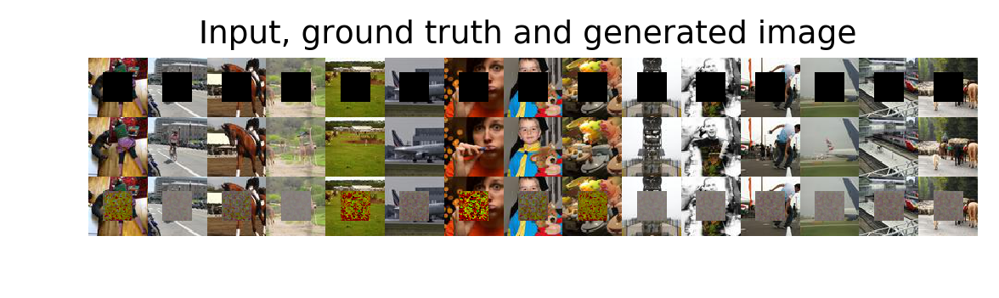

ae cost batch  0.0317084342241
ae cost batch  0.034181509167
D cost batch 48 -32.7910003662
ae cost batch  0.0330772995949
ae cost batch  0.0348984077573
ae cost batch  0.0328151099384
ae cost batch  0.0353166274726
D cost batch 53 -33.7533760071
ae cost batch  0.033336956054


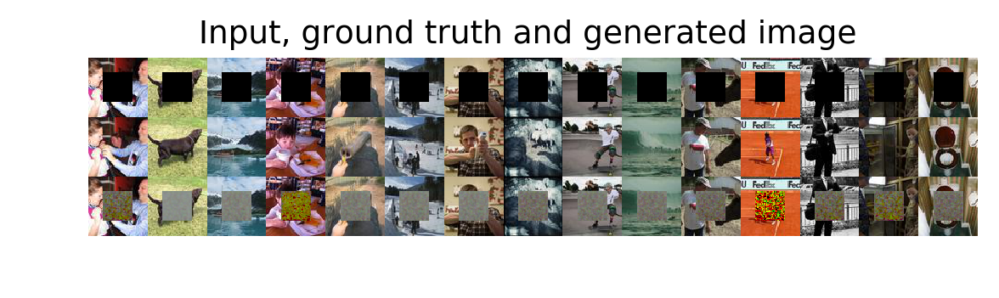

EPOCH 2: Avg cost train 1.548192, cost val 0.000000, took 72.440621 s
ae cost batch  0.0325169712305


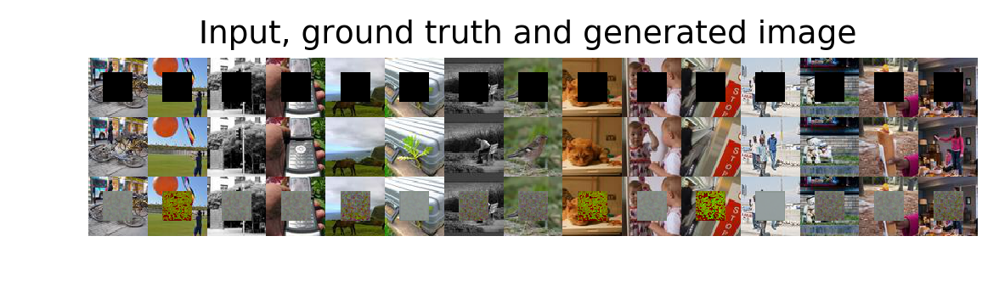

ae cost batch  0.0340056680143
D cost batch 2 -34.7392463684
ae cost batch  0.0339443124831
ae cost batch  0.0331221781671
ae cost batch  0.0341365486383
ae cost batch  nan
D cost batch 7 nan
ae cost batch  nan
ae cost batch  nan


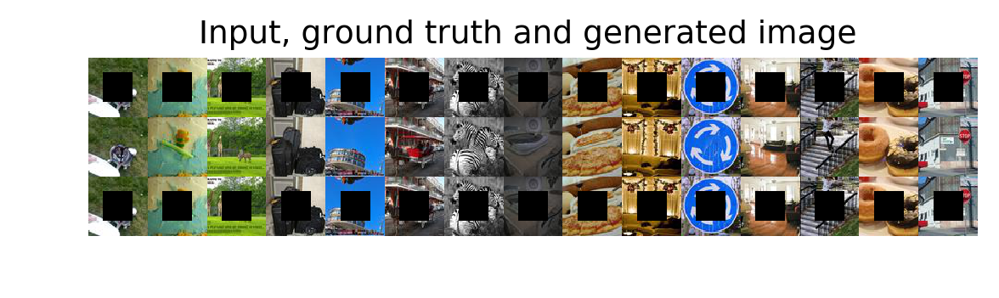

ae cost batch  nan
ae cost batch  nan
D cost batch 12 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 17 nan
ae cost batch  nan


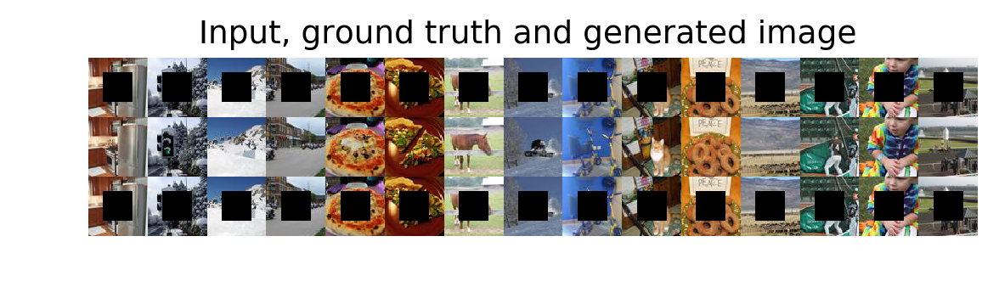

ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 22 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 27 nan


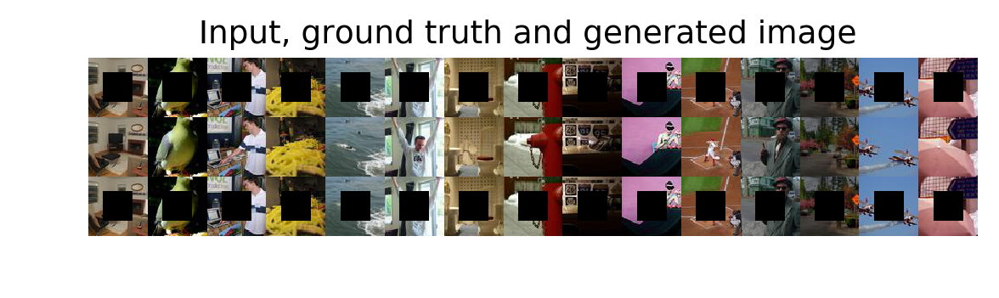

ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 32 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan


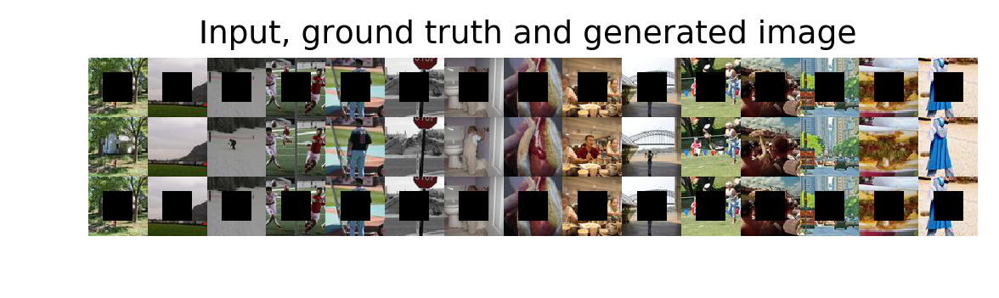

D cost batch 37 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 42 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan


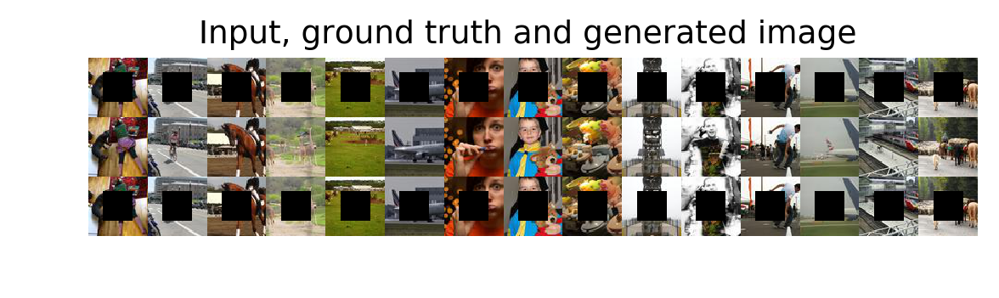

ae cost batch  nan
D cost batch 47 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 52 nan
ae cost batch  nan
ae cost batch  nan


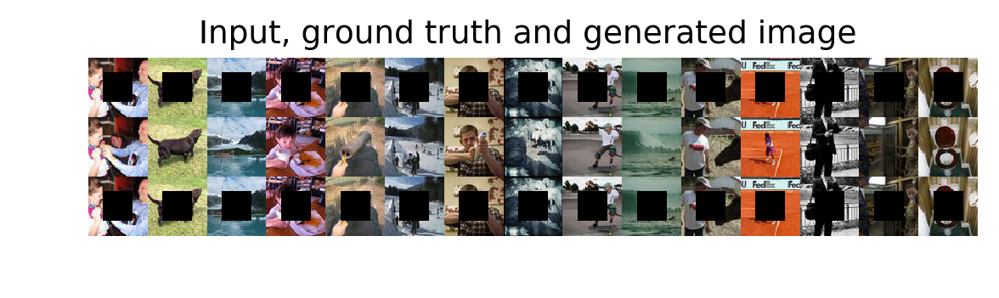

EPOCH 3: Avg cost train nan, cost val 0.000000, took 74.053485 s
ae cost batch  nan


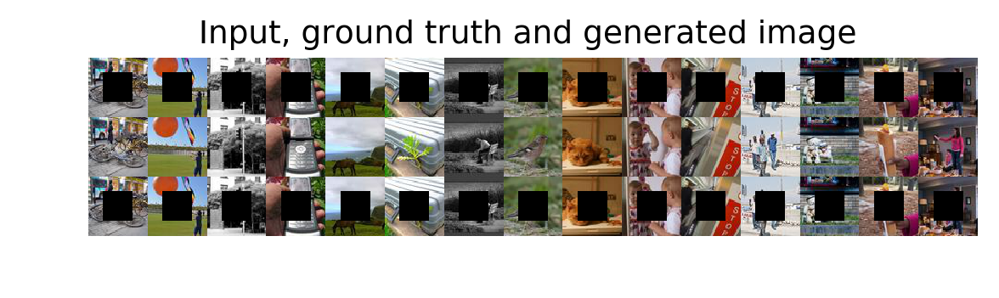

D cost batch 1 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 6 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan


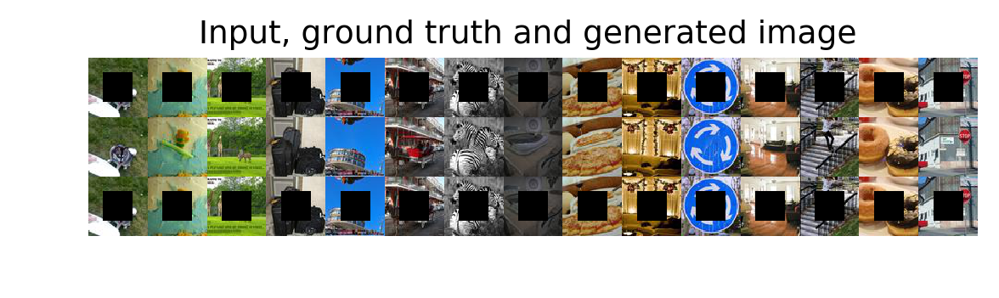

ae cost batch  nan
D cost batch 11 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 16 nan
ae cost batch  nan
ae cost batch  nan


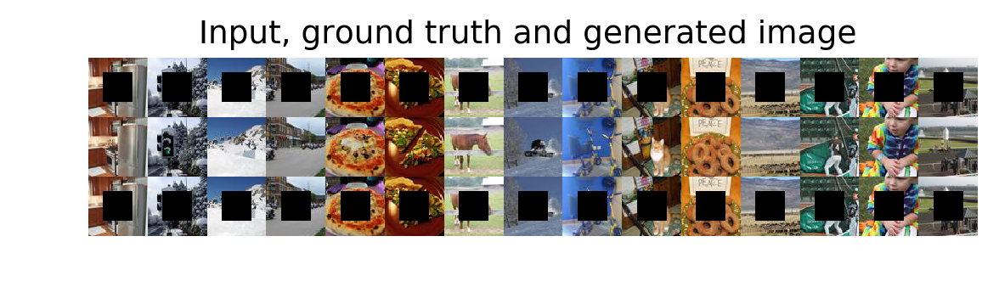

ae cost batch  nan
ae cost batch  nan
D cost batch 21 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 26 nan
ae cost batch  nan


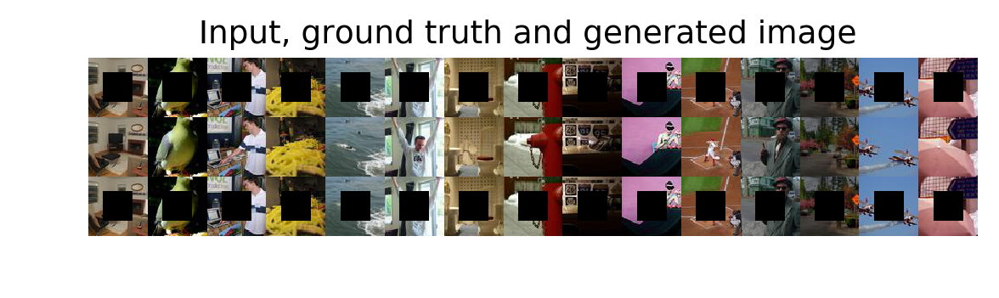

ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 31 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 36 nan


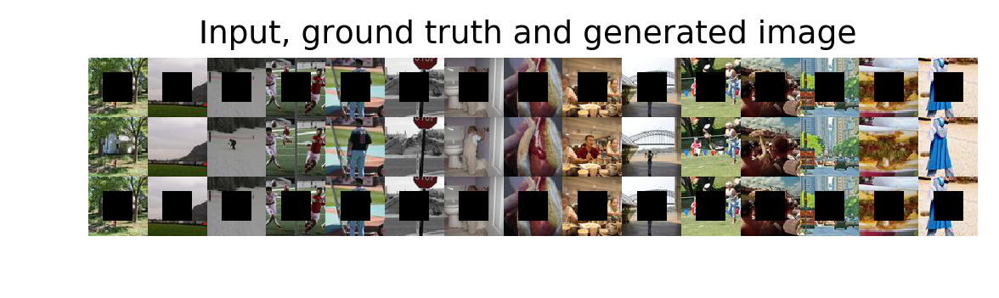

ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 41 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan


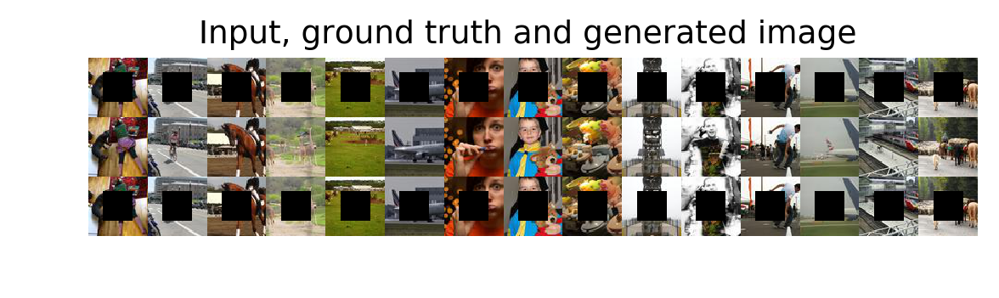

D cost batch 46 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 51 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan


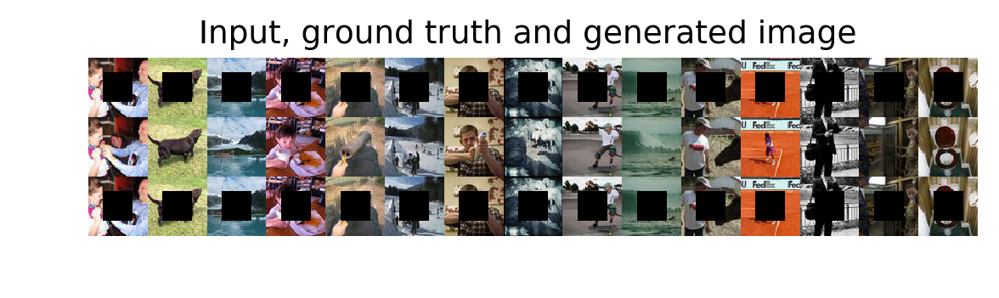

EPOCH 4: Avg cost train nan, cost val 0.000000, took 71.156660 s
D cost batch 0 nan


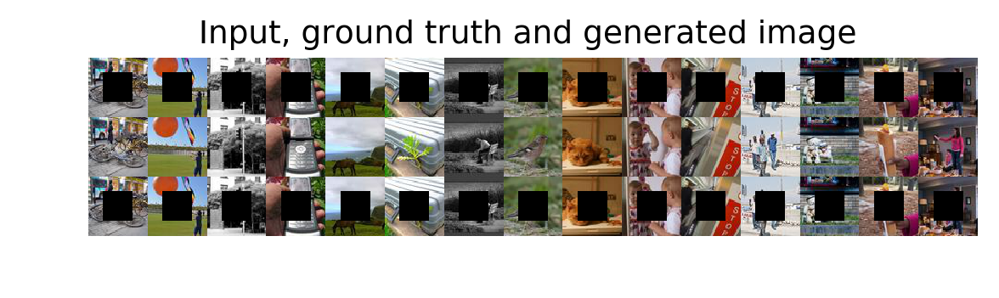

ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 5 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan


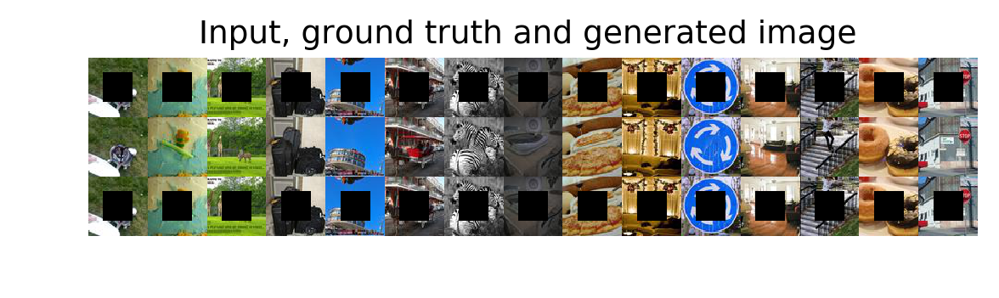

D cost batch 10 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 15 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan


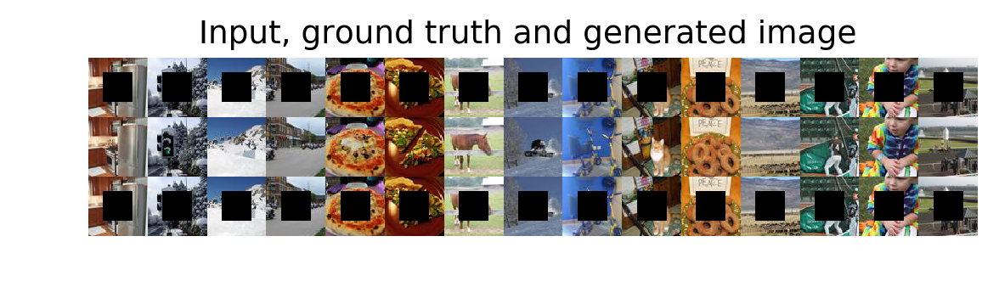

ae cost batch  nan
D cost batch 20 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 25 nan
ae cost batch  nan
ae cost batch  nan


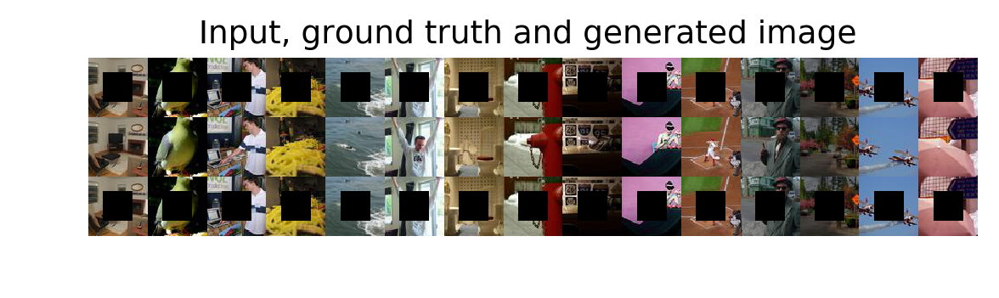

ae cost batch  nan
ae cost batch  nan
D cost batch 30 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 35 nan
ae cost batch  nan


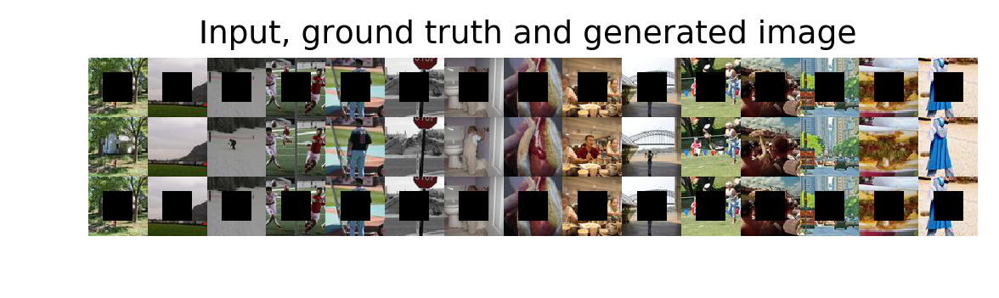

ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 40 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 45 nan


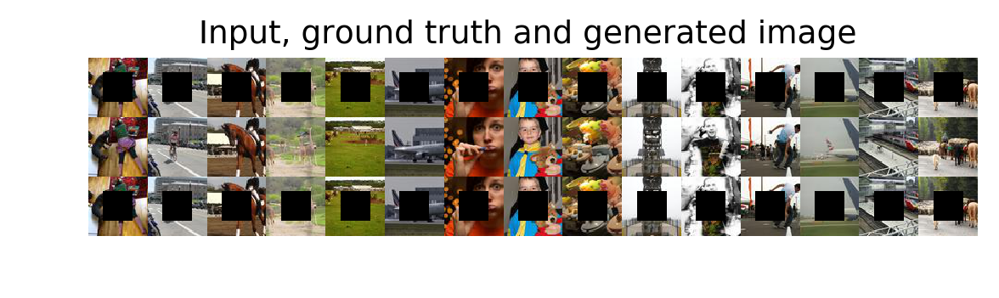

ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 50 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan


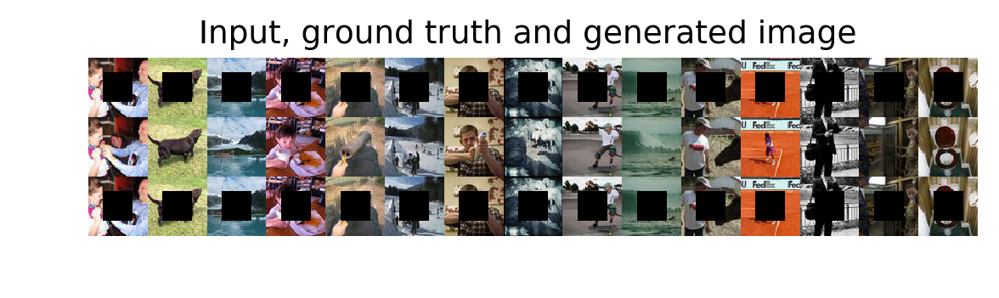

EPOCH 5: Avg cost train nan, cost val 0.000000, took 72.796892 s
ae cost batch  nan


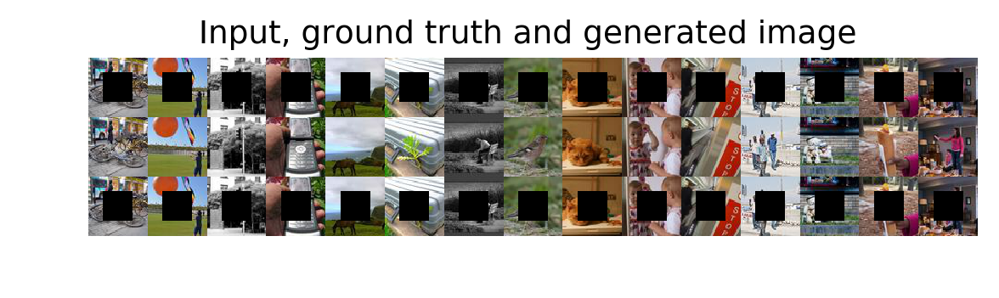

ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 4 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 9 nan


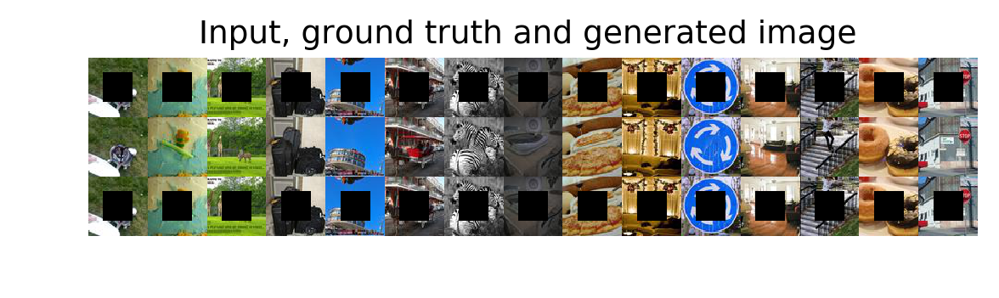

ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 14 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan


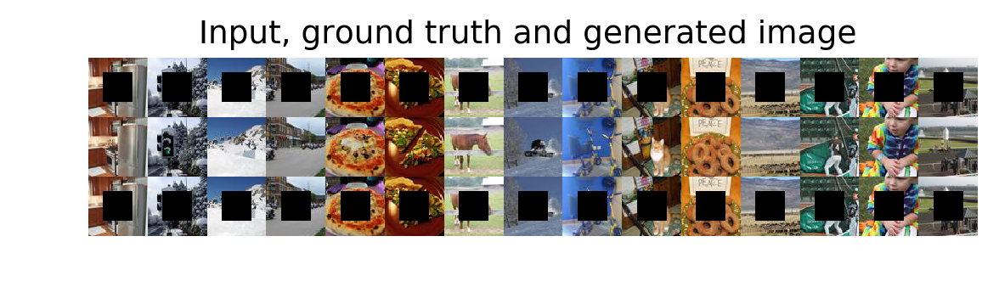

D cost batch 19 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 24 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan


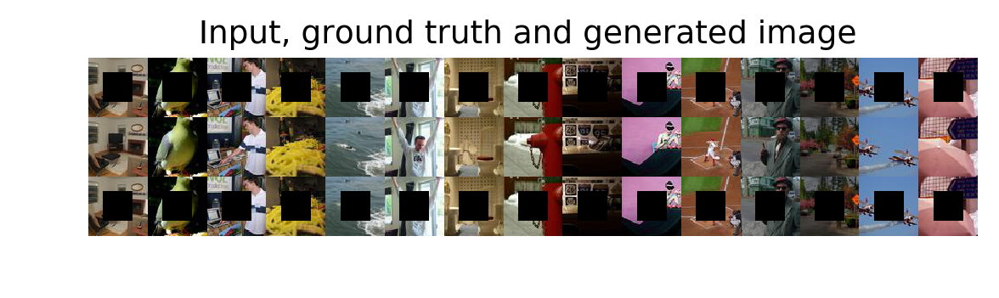

ae cost batch  nan
D cost batch 29 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 34 nan
ae cost batch  nan
ae cost batch  nan


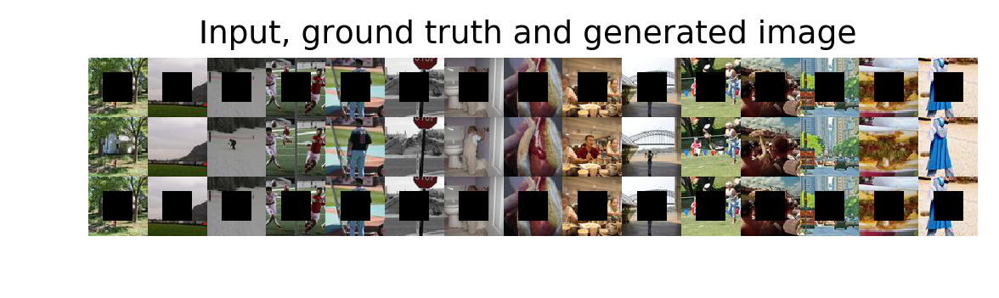

ae cost batch  nan
ae cost batch  nan
D cost batch 39 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 44 nan
ae cost batch  nan


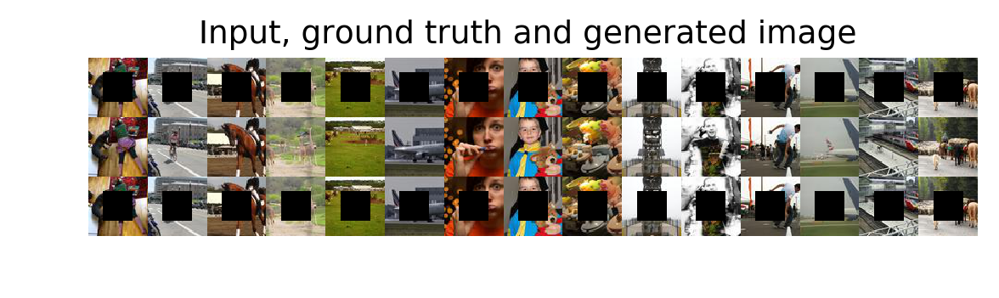

ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 49 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 54 nan


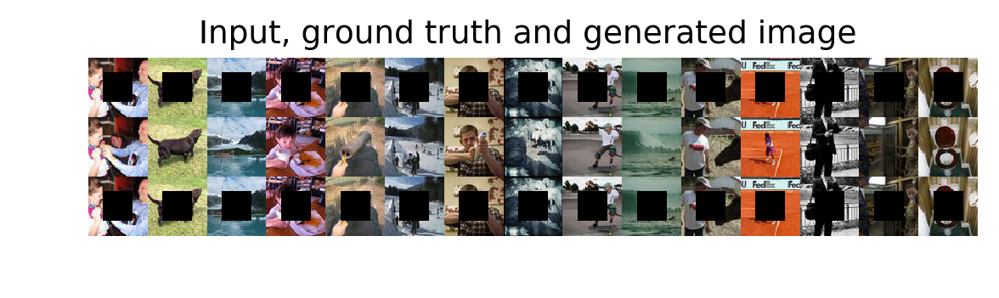

EPOCH 6: Avg cost train nan, cost val 0.000000, took 75.757385 s
ae cost batch  nan


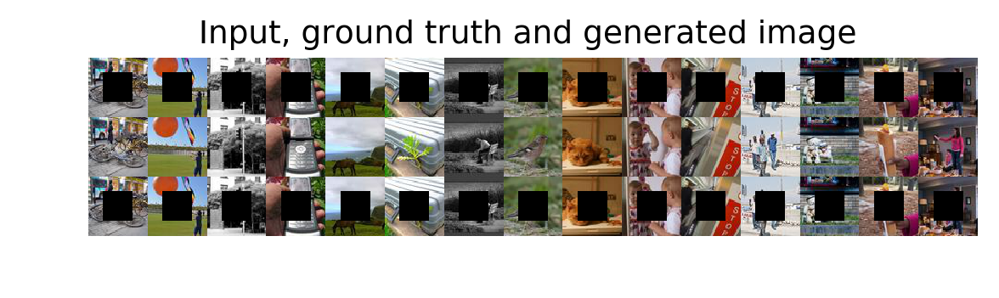

ae cost batch  nan
ae cost batch  nan
D cost batch 3 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 8 nan
ae cost batch  nan


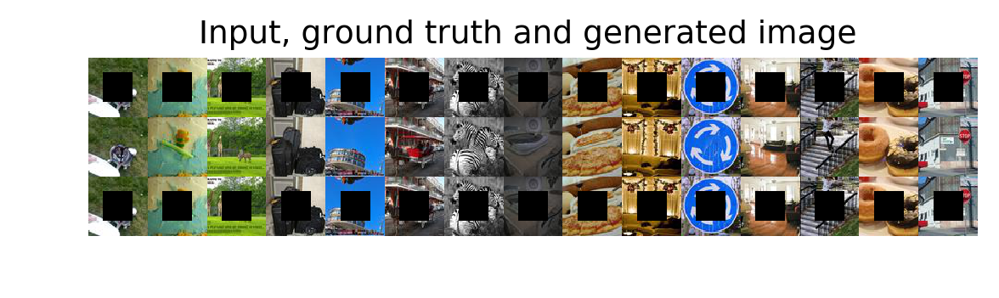

ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 13 nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 18 nan


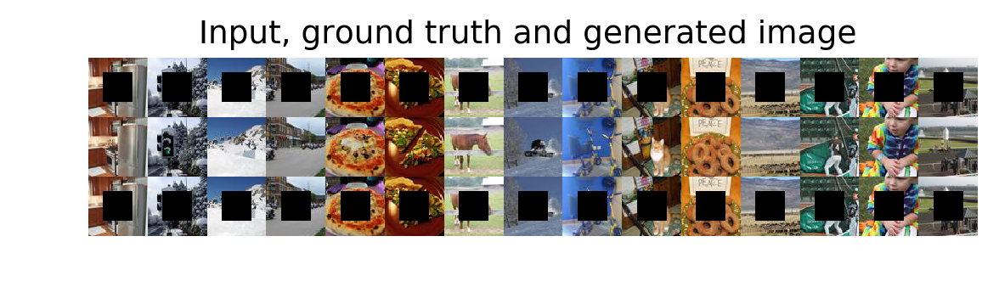

ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
ae cost batch  nan
D cost batch 23 nan
ae cost batch  nan


KeyboardInterrupt: 

In [15]:
#
# Train loop
#



# Training main loop
print "Start training"

for epoch in range(num_epochs):
    #learn_step.set_value((learn_step.get_value()*0.99).astype(theano.config.floatX))
    
    start_time = time.time()
    cost_train_epoch = 0
    cost_D_epoch = 0
    
    # Train      
        
    for i, train_batch in enumerate(train_iter):
        
        if n_batches_train > 0 and i> 54:#n_batches_train:
            break
          
        train_batch = model.extract_batch(train_batch)
        inputs_train, targets_train, caps_train = train_batch
        
        if (epoch+i)%5 ==0:
            
        
            cost_D_batch = D.train_fn(inputs_train, caps_train, targets_train)
            cost_D_epoch += cost_D_batch
            #Update epoch results   
            print 'D cost batch', i, cost_D_batch

#             if plot_results_train: #select random example from the last minibatch and plot it
#                 #model.compute_and_plot_results(train_batch, title='TRAIN DISCRIMINATOR')
#                 model.compute_and_plot_results((inputs_train[:15], targets_train[:15], caps_train[:15]), title = 'TRAIN DISCRIMINATOR')    
        else:


            cost_train_batch = model.train_fn(inputs_train, caps_train, targets_train)

            #print i, 'training batch cost : ', cost_train_batch

            #Update epoch results    
            cost_train_epoch += cost_train_batch

        
            print 'ae cost batch ' , cost_train_batch
#             if plot_results_train: #select random example from the last minibatch and plot it
#                 model.compute_and_plot_results((inputs_train[:15], targets_train[:15], caps_train[:15]), title = 'TRAIN GENERATOR')    
                #model.compute_and_plot_results(train_batch, title = 'TRAIN GENERATOR')

        if i%9==0:
            if plot_results_train: #select random example from the last minibatch and plot it
                model.compute_and_plot_results((inputs_train[:15], targets_train[:15], caps_train[:15]), title = '')#TRAIN GENERATOR')    
    
        
        
        
    #Add epoch results    
    err_train += [cost_train_epoch/n_batches_train]
    #err_D_train += [cost_D_epoch/n_batches_train]
    
    

    # Validation
    cost_val_epoch = 0
    

#     for i, valid_batch in enumerate(valid_iter):
        
#         if n_batches_valid > 0 and i> 0:#n_batches_valid:
#             break
#         print 'valid', i

#         valid_batch = model.extract_batch(valid_batch)
#         inputs_valid, targets_valid, caps_valid = valid_batch

#         # Validation step
#         cost_val_batch = model.valid_fn(inputs_valid, caps_valid, targets_valid)
#         #print i, 'validation batch cost : ', cost_val_batch


#         #Update epoch results
#         cost_val_epoch += cost_val_batch
        
    
#     if plot_results_valid: #select random example from the last minibatch and plot it
#         model.compute_and_plot_results(valid_batch, title = 'VALID')
        
    #Add epoch results 
    err_valid += [cost_val_epoch/n_batches_valid]
    

    #Print results (once per epoch)
    out_str = "EPOCH %i: Avg cost train %f, cost val %f, took %f s"
    out_str = out_str % (epoch, err_train[epoch],
                         err_valid[epoch],
                         time.time()-start_time)
    print out_str
   
    






In [ ]:
# #
# # Train loop
# #



# # Training main loop
# print "Start training"

# for epoch in range(num_epochs):
#     #learn_step.set_value((learn_step.get_value()*0.99).astype(theano.config.floatX))
    
#     start_time = time.time()
#     cost_train_epoch = 0
#     cost_D_epoch = 0
    
#     # Train      
        
#     for i, train_batch in enumerate(train_iter):
        
#         if n_batches_train > 0 and i> 2:#n_batches_train:
#             break
          
#         train_batch = model.extract_batch(train_batch)
#         inputs_train, targets_train, caps_train = train_batch
        
#         #print '-------------------------------------------------'
        
        
        
#         cost_D_batch = D.train_fn(inputs_train, caps_train, targets_train)
        
# #         if plot_results_train: #select random example from the last minibatch and plot it
# #             model.compute_and_plot_results(train_batch[:15], title = 'TRAIN DISCRIMINATOR')    
   
        
# #         D_b4 = D.get_before_nonlin(inputs_train[:10], caps_train[:10], targets_train[:10])
# #         print 'D non lin', np.array(D_b4)
# #         D_over_G_b4 = D_over_G.get_before_nonlin(inputs_train[:10], caps_train[:10], targets_train[:10])
# #         print 'D_over_G non lin', np.array(D_over_G_b4)
        
# #         D_p = D.get_pred(inputs_train[:10], caps_train[:10], targets_train[:10])
# #         print 'D predictions', str(D_p[:10])
# #         D_G_p = D_over_G.get_pred(inputs_train[:10], caps_train[:10], targets_train[:10])
# #         print 'D_over_G predictions', D_G_p[:10]
        
        
        
#         cost_D_epoch += cost_D_batch
#         #Update epoch results   
#     print 'D cost epoch', i, cost_D_epoch
    
#     if plot_results_train: #select random example from the last minibatch and plot it
#         #model.compute_and_plot_results(train_batch, title='TRAIN DISCRIMINATOR')
#         model.compute_and_plot_results((inputs_train[:15], targets_train[:15], caps_train[:15]), title = 'TRAIN DISCRIMINATOR')    
        
#     for i, train_batch in enumerate(train_iter):
        
#         if n_batches_train > 0 and i> 200:
#             break
        
        
#         train_batch = model.extract_batch(train_batch)
#         inputs_train, targets_train, caps_train = train_batch
        
#         cost_train_batch = model.train_fn(inputs_train, caps_train, targets_train)
        
#         #print i, 'training batch cost : ', cost_train_batch

#         #Update epoch results    
#         cost_train_epoch += cost_train_batch
        
        
#     print 'ae cost epoch ' , i, cost_train_epoch
#     if plot_results_train: #select random example from the last minibatch and plot it
#         model.compute_and_plot_results((inputs_train[:15], targets_train[:15], caps_train[:15]), title = 'TRAIN GENERATOR')    
#         #model.compute_and_plot_results(train_batch, title = 'TRAIN GENERATOR')
        
    
        
        
        
#     #Add epoch results    
#     err_train += [cost_train_epoch/n_batches_train]
    
    

#     # Validation
#     cost_val_epoch = 0
    

# #     for i, valid_batch in enumerate(valid_iter):
        
# #         if n_batches_valid > 0 and i> 0:#n_batches_valid:
# #             break
# #         print 'valid', i

# #         valid_batch = model.extract_batch(valid_batch)
# #         inputs_valid, targets_valid, caps_valid = valid_batch

# #         # Validation step
# #         cost_val_batch = model.valid_fn(inputs_valid, caps_valid, targets_valid)
# #         #print i, 'validation batch cost : ', cost_val_batch


# #         #Update epoch results
# #         cost_val_epoch += cost_val_batch
        
    
# #     if plot_results_valid: #select random example from the last minibatch and plot it
# #         model.compute_and_plot_results(valid_batch, title = 'VALID')
        
#     #Add epoch results 
#     err_valid += [cost_val_epoch/n_batches_valid]
    

#     #Print results (once per epoch)
#     out_str = "EPOCH %i: Avg cost train %f, cost val %f, took %f s"
#     out_str = out_str % (epoch, err_train[epoch],
#                          #acc_train[epoch],
#                          err_valid[epoch],
#                          #acc_valid[epoch],
#                          time.time()-start_time)
#     print out_str
   
    






In [ ]:
    # Early stopping and saving stuff
    
#     with open(os.path.join(savepath, "ae_output.log"), "a") as f:
#         f.write(out_str + "\n")
        
#     if epoch == 0 and reset_best_results:
#         best_err_valid = err_valid[epoch]
#     elif epoch > 1 and err_valid[epoch] < best_err_valid:
#         print('saving best (and last) model')
#         best_err_valid = err_valid[epoch]
#         patience = 0
#         np.savez(os.path.join(savepath, 'ae_model_best.npz'),*lasagne.layers.get_all_param_values(model.net))
#         np.savez(os.path.join(savepath , "ae_errors_best.npz"), err_train=err_train, err_valid=err_valid)
#         np.savez(os.path.join(savepath, 'ae_model_last.npz'), *lasagne.layers.get_all_param_values(model.net))
#         np.savez(os.path.join(savepath , "ae_errors_last.npz"), err_train=err_train, err_valid=err_valid)
        
#         np.savez(os.path.join(savepath, 'D_model_best.npz'),*lasagne.layers.get_all_param_values(D.net))
#         np.savez(os.path.join(savepath, 'D_model_last.npz'), *lasagne.layers.get_all_param_values(D.net))
        
#     else:
#         patience += 1
#         print('saving last model')
#         np.savez(os.path.join(savepath, 'ae_model_last.npz'), *lasagne.layers.get_all_param_values(model.net))
#         np.savez(os.path.join(savepath, 'D_model_last.npz'), *lasagne.layers.get_all_param_values(D.net))
#         np.savez(os.path.join(savepath , "ae_errors_last.npz"), err_train=err_train, err_valid=err_valid)
        
#     # Finish training if patience has expired or max nber of epochs reached
#     if patience == max_patience or epoch == num_epochs-1:
#         if savepath != loadpath:
#             print('Copying model and other training files to {}'.format(loadpath))
#             copy_tree(savepath, loadpath)
#         break 